In [1]:
# !pip install -q fsspec
# !pip install -q gcsfs
# !pip install -q scanpy
# !pip install -q anndata
# !pip install numpy


In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
# import squidpy as sq
import anndata as ad
from scipy import stats
# from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
from typing import Optional, List, Dict, Tuple
import cellphonedb
import harmonypy
import gseapy as gp
import napari
import os
import mpl_toolkits
import json

import numpy as np
import pandas as pd
import scanpy as sc
from scipy.spatial import ConvexHull
from shapely.geometry import Polygon, Point
from sklearn.cluster import DBSCAN
import alphashape
from typing import List, Dict, Tuple, Optional
import matplotlib.pyplot as plt
import seaborn as sns

from scipy.ndimage import gaussian_filter
from scipy.interpolate import splprep, splev
from sklearn.neighbors import KernelDensity
from skimage import measure
import numpy as np
from typing import List, Dict, Optional, Tuple

ModuleNotFoundError: No module named 'cellphonedb'

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
import sys
sys.path.append('/Users/u0096223/Documents/GitHub/PVLabTime/Merscope')
from MerscopeBrainAnalysis import MerscopeBrainAnalysis
# from GeneAnnotator import GeneAnnotator

In [ ]:
data_dir = '/Users/u0096223/Baidu/Science/Data PVDH/MERSCOPE data/P5_mouse_brain_CBD_panel/Cells'
anndata_filename = os.path.join(data_dir,'15-11-24_23-22_P5_mouse_brain_CBD_panel_Cells_annotated.h5ad')
anndata_filename = os.path.join(data_dir,'Spoint_result_mouse_brain_st.h5ad.h5ad') # result of SPOINT

fig_root = os.path.join(data_dir,'Figures')

In [ ]:
print(anndata_filename)
analysis = MerscopeBrainAnalysis(
    h5ad_path=anndata_filename
)

In [6]:
analysis.adata.obs

,Custom Cells groups,Datasets,volume,center_x,center_y,cell_id,class_label,class_name,class_correlation_coefficient,subclass_label,subclass_name,subclass_correlation_coefficient,supertype_label,supertype_name,supertype_correlation_coefficient,cluster_label,cluster_name,cluster_alias,cluster_correlation_coefficient,leiden
4176488300005100074,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,918.626099,3135.893269,407.215646,4176488300005100074,CS20230722_CLAS_33,33 Vascular,0.5529,CS20230722_SUBC_329,329 ABC NN,0.5529,CS20230722_SUPT_1186,1186 ABC NN_1,0.5529,CS20230722_CLUS_5294,5294 ABC NN_1,5257,0.5529,9
4176488300005100077,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1296.579224,3093.065556,416.124569,4176488300005100077,CS20230722_CLAS_14,14 HY Glut,0.3800,CS20230722_SUBC_129,129 VMH Nr5a1 Glut,0.3800,CS20230722_SUPT_0566,0566 VMH Nr5a1 Glut_1,0.3800,CS20230722_CLUS_2304,2304 VMH Nr5a1 Glut_1,2086,0.3800,21
4176488300005100078,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1098.988892,3140.836221,414.966652,4176488300005100078,CS20230722_CLAS_33,33 Vascular,0.5413,CS20230722_SUBC_330,330 VLMC NN,0.5413,CS20230722_SUPT_1187,1187 VLMC NN_1,0.5413,CS20230722_CLUS_5296,5296 VLMC NN_1,5259,0.5413,9
4176488300005100079,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1901.925781,3147.923169,418.713692,4176488300005100079,CS20230722_CLAS_33,33 Vascular,0.6124,CS20230722_SUBC_330,330 VLMC NN,0.6124,CS20230722_SUPT_1187,1187 VLMC NN_1,0.6124,CS20230722_CLUS_5296,5296 VLMC NN_1,5259,0.6124,9
4176488300005100084,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,825.530334,3150.803025,427.134870,4176488300005100084,CS20230722_CLAS_33,33 Vascular,0.4082,CS20230722_SUBC_330,330 VLMC NN,0.4082,CS20230722_SUPT_1187,1187 VLMC NN_1,0.4082,CS20230722_CLUS_5296,5296 VLMC NN_1,5259,0.4082,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4176488700194200069,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,1077.251953,4224.746444,12715.737318,4176488700194200069,CS20230722_CLAS_33,33 Vascular,0.4778,CS20230722_SUBC_330,330 VLMC NN,0.4778,CS20230722_SUPT_1188,1188 VLMC NN_2,0.4778,CS20230722_CLUS_5300,5300 VLMC NN_2,5262,0.4778,9
4176488700194200077,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,879.106812,4137.425501,12724.852494,4176488700194200077,CS20230722_CLAS_30,30 Astro-Epen,0.2980,CS20230722_SUBC_323,323 Ependymal NN,0.2980,CS20230722_SUPT_1176,1176 Ependymal NN_2,0.2980,CS20230722_CLUS_5261,5261 Ependymal NN_2,14877,0.2980,34
4176488700194200083,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,731.352478,4071.412604,12723.966420,4176488700194200083,CS20230722_CLAS_33,33 Vascular,0.2601,CS20230722_SUBC_333,333 Endo NN,0.2601,CS20230722_SUPT_1193,1193 Endo NN_1,0.2601,CS20230722_CLUS_5311,5311 Endo NN_1,5255,0.2601,34
4176488700194200116,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,677.103821,4096.312602,12741.254466,4176488700194200116,CS20230722_CLAS_25,25 Pineal Glut,0.3208,CS20230722_SUBC_262,262 Pineal Crx Glut,0.3208,CS20230722_SUPT_1030,1030 Pineal Crx Glut_1,0.3208,CS20230722_CLUS_4606,4606 Pineal Crx Glut_1,5149,0.3208,34


### annotate genes in the gene panel, not necessary yet

In [ ]:
analysis.adata.obs
adata=analysis.adata.copy()

In [ ]:
# Initialize annotator
annotator = GeneAnnotator()

# Get gene annotations
genes = adata.var_names.tolist()
annotations = annotator.annotate_genes(
    genes,
    min_evidence=1
)

# Print statistics
annotator._print_annotation_stats(annotations)

# Get detailed summary
summary = annotator.get_annotation_summary(annotations)

# Generate visualization plots
figures = annotator.plot_annotation_summary(annotations)
plt.show()

# Export comprehensive report
annotator.export_annotation_report(annotations, fig_root)

In [ ]:
# Generate all visualizations
figures = annotator.plot_gene_annotations(
    annotations,
    save_path=fig_root,
    figsize_base=(12, 10)
)

# Show each visualization
for name, fig in figures.items():
    plt.figure(fig.number)
    plt.show()

In [ ]:

# Generate overall network with clear separation
fig_network = annotator._plot_function_network(
    annotations,
    figsize=(20, 15),
    node_spacing=1.5  # Adjust this to control horizontal spread
)

# Generate category-specific network
for category in ['neural_development', 'synaptic_function']:
    fig_category = annotator._plot_function_network(
        annotations,
        category=category,
        figsize=(20, 15),
        node_spacing=1.5,
        min_edge_weight=3
    )
    plt.show()

In [ ]:
# Generate network
fig_network = annotator._plot_function_network(
    annotations,
    figsize=(20, 15),
    node_spacing=1.5
)

if fig_network is not None:
    # Get network statistics
    stats = annotator.get_node_statistics(G)
    
    print("\nNetwork Statistics:")
    print(f"Total nodes: {stats['total_nodes']}")
    print(f"Total edges: {stats['edges']}")
    print("\nTop Terms:")
    for term, score in stats['terms']['top_terms']:
        print(f"  {term}: {score:.2f}")
    
    plt.show()

In [ ]:
# Add annotations to AnnData object
annotator.add_annotations_to_adata(adata, annotations)

# Get genes for a specific category
neural_dev_genes = annotator.get_category_genes(annotations, 'neural_development')

In [ ]:
annotations


### plot cell properties in space

In [ ]:
# Basic preprocessing and clustering
# analysis.preprocess_data()

In [ ]:
# analysis.run_dimensionality_reduction(harmony_batch_key='batch')

In [13]:
# run leiden cluster 
adata= analysis.adata.copy()
sc.tl.leiden(adata,resolution = 0.5)

In [14]:
adata.obs


# analysis.adata.write(anndata_filename)

,Custom Cells groups,Datasets,volume,center_x,center_y,cell_id,class_label,class_name,class_correlation_coefficient,subclass_label,subclass_name,subclass_correlation_coefficient,supertype_label,supertype_name,supertype_correlation_coefficient,cluster_label,cluster_name,cluster_alias,cluster_correlation_coefficient,leiden
4176488300005100074,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,918.626099,3135.893269,407.215646,4176488300005100074,CS20230722_CLAS_33,33 Vascular,0.5529,CS20230722_SUBC_329,329 ABC NN,0.5529,CS20230722_SUPT_1186,1186 ABC NN_1,0.5529,CS20230722_CLUS_5294,5294 ABC NN_1,5257,0.5529,2
4176488300005100077,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1296.579224,3093.065556,416.124569,4176488300005100077,CS20230722_CLAS_14,14 HY Glut,0.3800,CS20230722_SUBC_129,129 VMH Nr5a1 Glut,0.3800,CS20230722_SUPT_0566,0566 VMH Nr5a1 Glut_1,0.3800,CS20230722_CLUS_2304,2304 VMH Nr5a1 Glut_1,2086,0.3800,0
4176488300005100078,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1098.988892,3140.836221,414.966652,4176488300005100078,CS20230722_CLAS_33,33 Vascular,0.5413,CS20230722_SUBC_330,330 VLMC NN,0.5413,CS20230722_SUPT_1187,1187 VLMC NN_1,0.5413,CS20230722_CLUS_5296,5296 VLMC NN_1,5259,0.5413,2
4176488300005100079,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1901.925781,3147.923169,418.713692,4176488300005100079,CS20230722_CLAS_33,33 Vascular,0.6124,CS20230722_SUBC_330,330 VLMC NN,0.6124,CS20230722_SUPT_1187,1187 VLMC NN_1,0.6124,CS20230722_CLUS_5296,5296 VLMC NN_1,5259,0.6124,2
4176488300005100084,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,825.530334,3150.803025,427.134870,4176488300005100084,CS20230722_CLAS_33,33 Vascular,0.4082,CS20230722_SUBC_330,330 VLMC NN,0.4082,CS20230722_SUPT_1187,1187 VLMC NN_1,0.4082,CS20230722_CLUS_5296,5296 VLMC NN_1,5259,0.4082,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4176488700194200069,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,1077.251953,4224.746444,12715.737318,4176488700194200069,CS20230722_CLAS_33,33 Vascular,0.4778,CS20230722_SUBC_330,330 VLMC NN,0.4778,CS20230722_SUPT_1188,1188 VLMC NN_2,0.4778,CS20230722_CLUS_5300,5300 VLMC NN_2,5262,0.4778,2
4176488700194200077,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,879.106812,4137.425501,12724.852494,4176488700194200077,CS20230722_CLAS_30,30 Astro-Epen,0.2980,CS20230722_SUBC_323,323 Ependymal NN,0.2980,CS20230722_SUPT_1176,1176 Ependymal NN_2,0.2980,CS20230722_CLUS_5261,5261 Ependymal NN_2,14877,0.2980,15
4176488700194200083,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,731.352478,4071.412604,12723.966420,4176488700194200083,CS20230722_CLAS_33,33 Vascular,0.2601,CS20230722_SUBC_333,333 Endo NN,0.2601,CS20230722_SUPT_1193,1193 Endo NN_1,0.2601,CS20230722_CLUS_5311,5311 Endo NN_1,5255,0.2601,15
4176488700194200116,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,677.103821,4096.312602,12741.254466,4176488700194200116,CS20230722_CLAS_25,25 Pineal Glut,0.3208,CS20230722_SUBC_262,262 Pineal Crx Glut,0.3208,CS20230722_SUPT_1030,1030 Pineal Crx Glut_1,0.3208,CS20230722_CLUS_4606,4606 Pineal Crx Glut_1,5149,0.3208,15


[<Axes: title={'center': 'class_name - 202411071245_Xu-P5-ms-brain_VMSC08602_region_0'}>,
 <Axes: title={'center': 'class_name - 202411071245_Xu-P5-ms-brain_VMSC08602_region_1'}>]

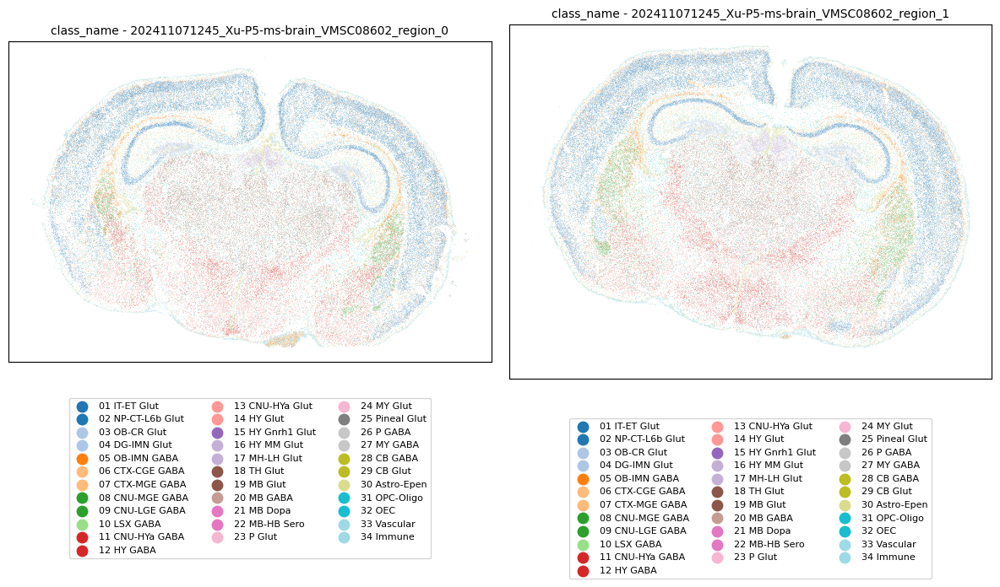

In [6]:
# Categorical data (e.g., clusters) - will use scanpy's default colors
analysis.plot_spatial_feature(
    'class_name',
    spot_size=0.1,
    legend_loc ='bottom'
)

[<Axes: title={'center': 'supertype_name - 202411071245_Xu-P5-ms-brain_VMSC08602_region_0'}>,
 <Axes: title={'center': 'supertype_name - 202411071245_Xu-P5-ms-brain_VMSC08602_region_1'}>]

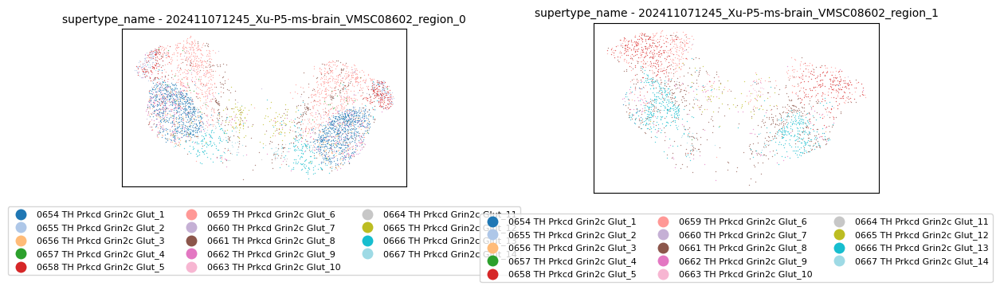

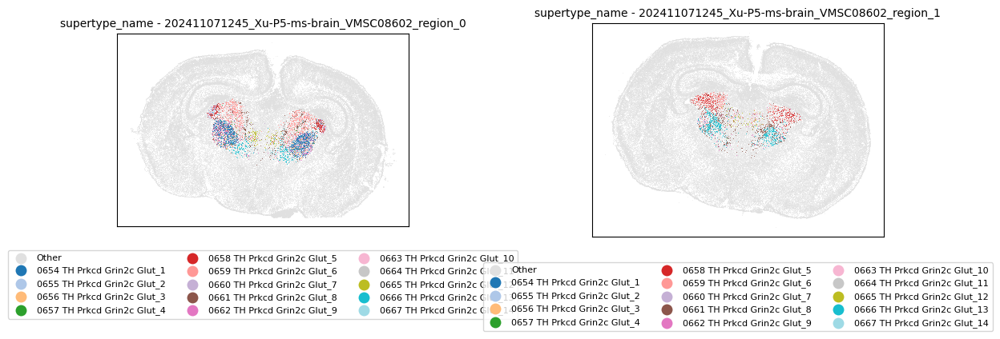

In [14]:
# show multiple cell groups in selected cell class or subclass 
groups_level1_name = 'class_name'
groups_level1_sel = ['01 IT-ET Glut']
groups_level2_name = 'subclass_name'

groups_level1_name = 'subclass_name'
groups_level1_sel = ['151 TH Prkcd Grin2c Glut']
groups_level2_name = 'supertype_name'

adata_th=analysis.adata.copy()
# adata_th=adata_th[adata_th.obs['subclass_name'].isin(['151 TH Prkcd Grin2c Glut'])]
adata_th=adata_th[adata_th.obs[groups_level1_name].isin(groups_level1_sel)]
list_group= adata_th.obs[groups_level2_name].unique()
list_group

analysis.plot_spatial_feature(
    feature = groups_level2_name,
    categories_to_plot = list_group,
    spot_size=1,
    legend_loc ='bottom',
    show_background=False
)

analysis.plot_spatial_feature(
    feature = groups_level2_name,
    categories_to_plot = list_group,
    spot_size=0.5,
    legend_loc ='bottom',
    show_background=True
)


[<Axes: title={'center': 'Aldh1a3 - 202411071245_Xu-P5-ms-brain_VMSC08602_region_0'}>,
 <Axes: title={'center': 'Aldh1a3 - 202411071245_Xu-P5-ms-brain_VMSC08602_region_1'}>]

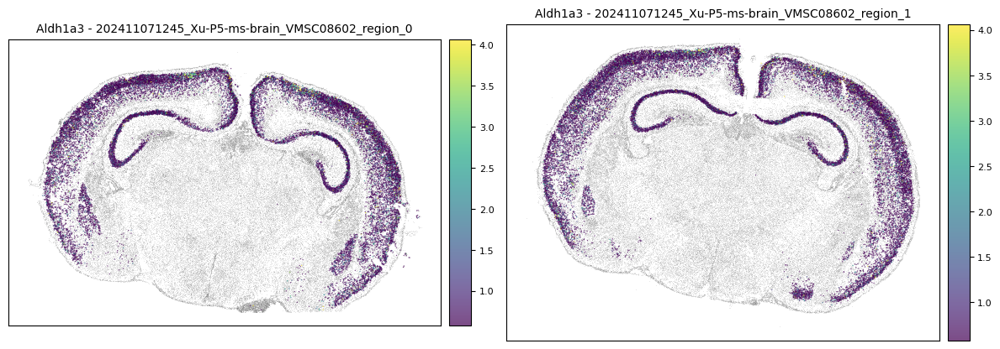

In [12]:
# Plot spatial feature for selected cells
criteria1 = {
    'gene_expression': ['Gad2','Npy', '-Nos1']
}
criteria1 = {
    'class_name': ['01 IT-ET Glut']
}
selected = analysis.select_cells(criteria1)


analysis.plot_spatial_feature(
    'Aldh1a3',
    selected_cells=selected,
    color_map = 'viridis',
    spot_size=1,
    legend_markersize=10,
    legend_loc ='bottom',
    show_background = True,
    background_color = '#000000'
)

In [22]:
# Plot spatial feature for selected cells

group_name = 'class_name'
group_now = '08 CNU-MGE GABA'

criteria = {
    group_name: [group_now],
    'supertype_name': ['0239 Sst Chodl Gaba_2','0241 Sst Chodl Gaba_4']
}
selected = analysis.select_cells(criteria)


analysis.plot_spatial_feature(
    feature = 'supertype_name',
    selected_cells=selected,
    color_map = 'viridis',
    spot_size=5,
    legend_markersize=10,
    legend_loc ='bottom',
    show_background = True,
    background_color = '#BBBBBB'
)

# Save the figure
fig_name = os.path.join(fig_root,'cell_distribution_subclasses_in_{}.png'.format(group_now))
plt.savefig(fig_name, dpi=600)

# Close the figure to avoid overlapping plots
plt.close()


In [14]:
# # plot colorcoded multiple cell groups in individual classes
group_name = 'class_name'
adata_th=analysis.adata.copy()
list_group= adata_th.obs[group_name].unique()

for group_now in list_group:
    criteria = {
        group_name: [group_now]
    }
    
    selected = analysis.select_cells(criteria)
    
    analysis.plot_spatial_feature(
        feature = 'subclass_name',
        selected_cells=selected,
        spot_size=1,
        legend_markersize=10,
        legend_loc ='bottom',
        show_background = True,
        background_color = '#000000'
    )

    # Save the figure
    fig_name = os.path.join(fig_root,'cell_distribution_subclasses_in_{}.png'.format(group_now))
    plt.savefig(fig_name, dpi=600)
    
    # Close the figure to avoid overlapping plots
    plt.close()


/Users/u0096223/Documents/GitHub/PVLabTime/Merscope/MerscopeBrainAnalysis.py:1320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 3, figsize=(20, 7))


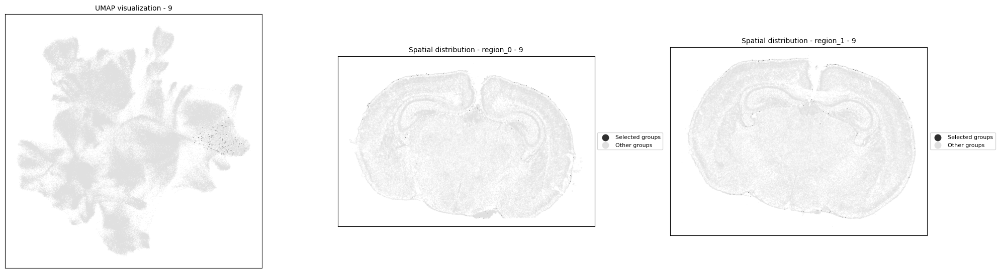

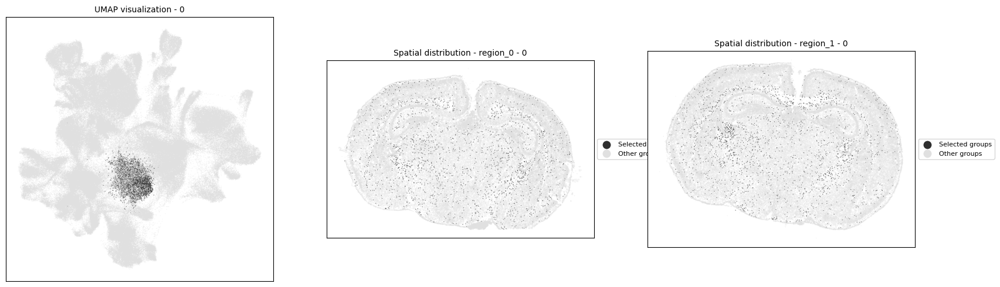

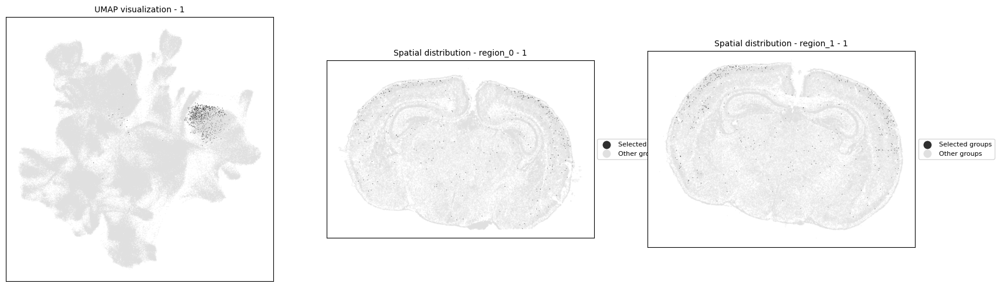

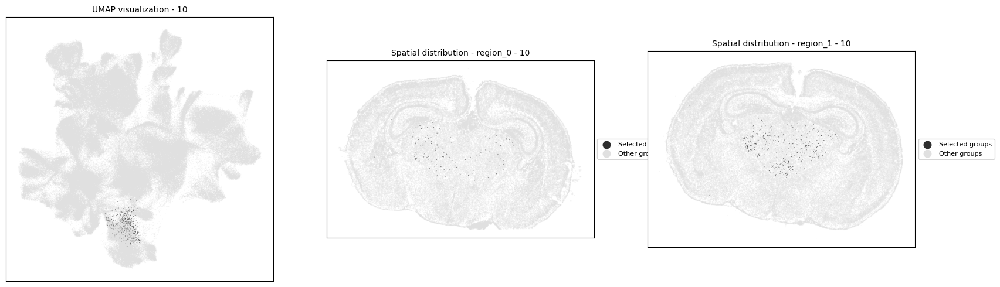

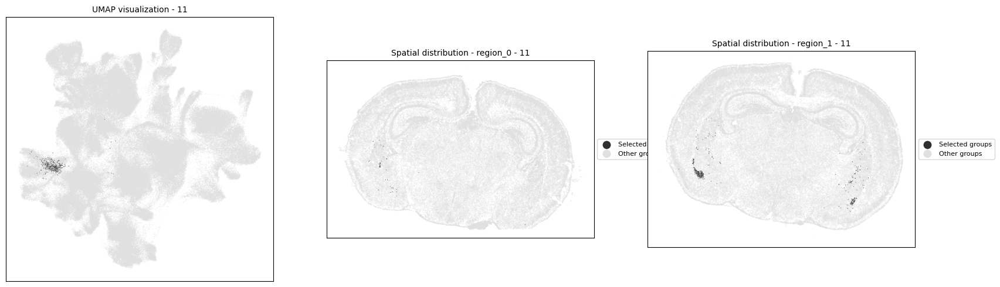

...

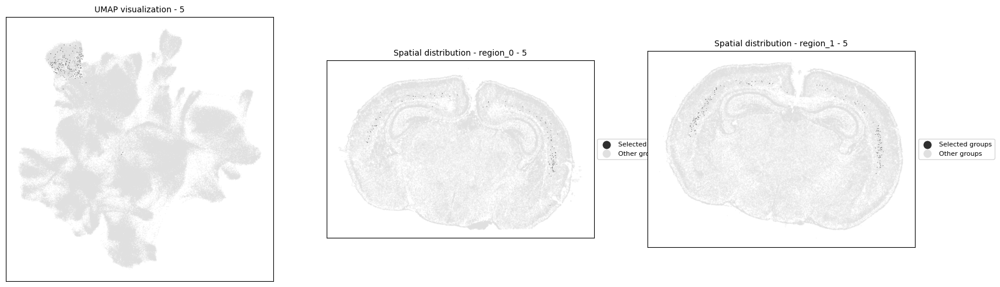

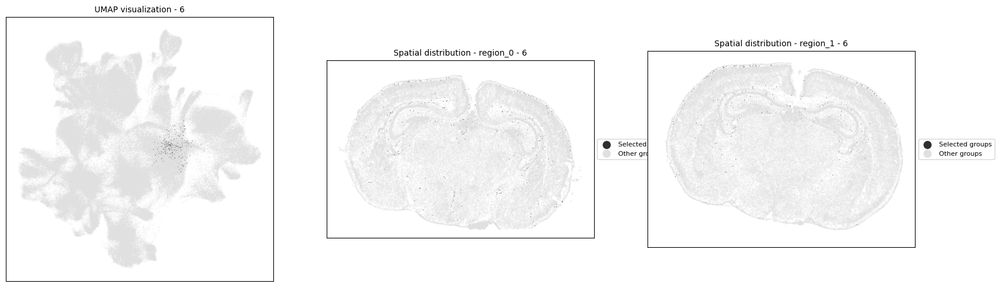

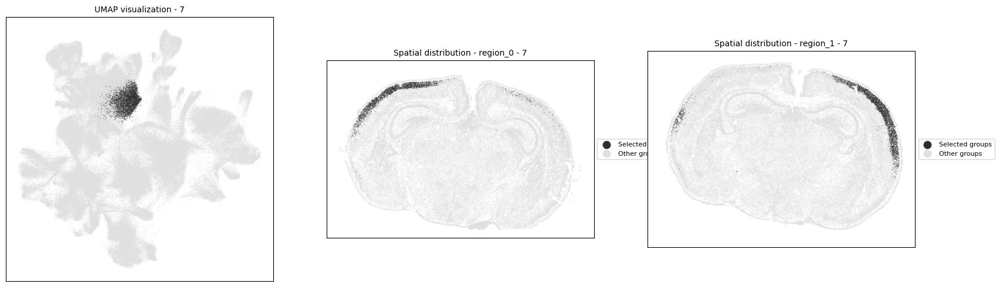

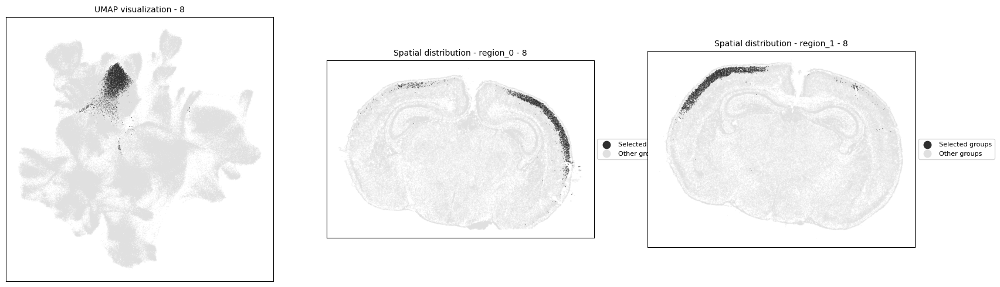

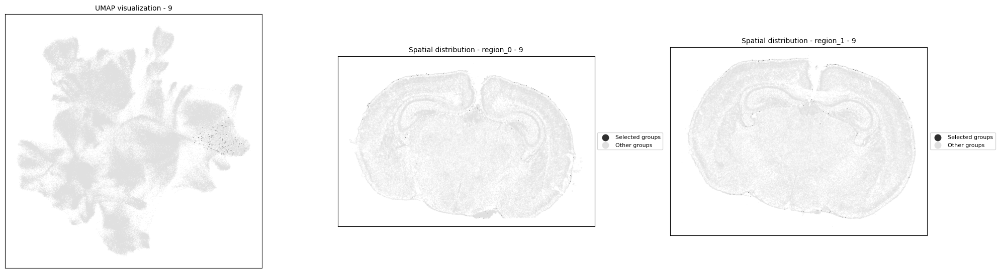

In [36]:
# Highlight groups for selected cells
analysis.highlight_groups(
    cell_group = 'leiden',
    selected_cells=selected,
    spot_size=1.0
)

[<Axes: title={'center': 'class_name - 202411071245_Xu-P5-ms-brain_VMSC08602_region_0'}>,
 <Axes: title={'center': 'class_name - 202411071245_Xu-P5-ms-brain_VMSC08602_region_1'}>]

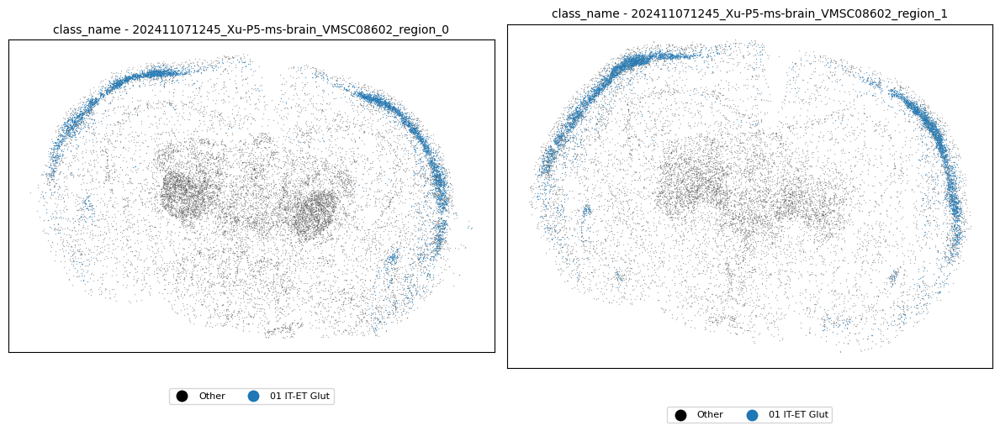

In [37]:
# Plot with gene co-expression and categorical selection
selected = analysis.select_cells_by_expression(['Cux2','Rorb'])
analysis.plot_spatial_feature(
    feature = 'class_name',
    selected_cells=selected,
    categories_to_plot=['01 IT-ET Glut'],
    spot_size=1.0,
    legend_markersize=10,
    background_color ='#000000',
    legend_loc = 'bottom'
)

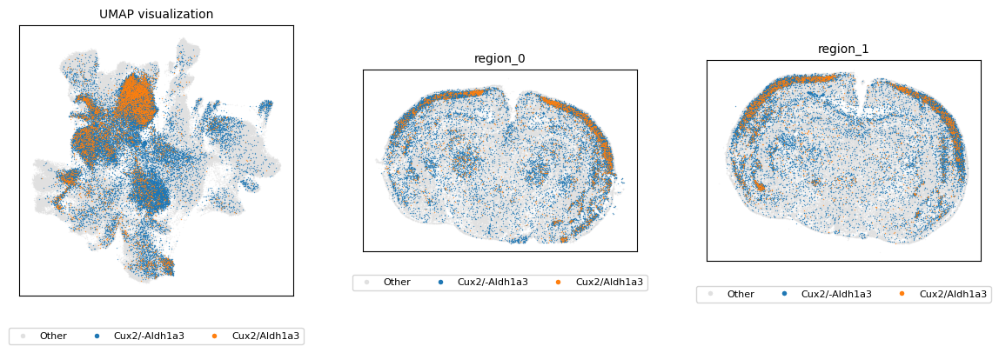

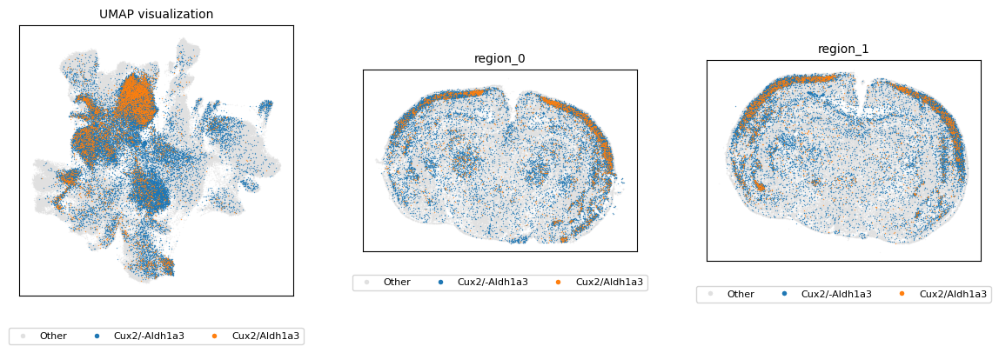

In [8]:
# example, Select cells based on multiple criteria and plot different groups in UMAP and space
criteria1 = {
    'gene_expression': ['Cux2','-Aldh1a3']
}
mask1 = analysis.select_cells(criteria1)
group1  = "/".join(criteria1['gene_expression'])

criteria2 = {
    'gene_expression': ['Cux2','Aldh1a3']
}
mask2 = analysis.select_cells(criteria2)
group2  = "/".join(criteria2['gene_expression'])


# Create dictionary of cell groups
selected_groups = {
    group1: mask1,
    group2: mask2,
}

# Plot with manual dictionary
analysis.plot_spatial_manual_dictionary(
    selected_groups,
    show_umap=True,
    spot_size =1,
    legend_loc ='bottom'
)

In [9]:
# example, Select cells based on multiple criteria and plot them in UMAP and space
criteria1 = {
    'gene_expression': ['Gad2','Npy', 'Nos1']
}
mask1 = analysis.select_cells(criteria1)
group1  = "/".join(criteria1['gene_expression'])

criteria2 = {
    'gene_expression': ['Gad2','Npy', '-Nos1']
}
mask2 = analysis.select_cells(criteria2)
group2  = "/".join(criteria2['gene_expression'])


# Create dictionary of cell groups
selected_groups = {
    group1: mask1,
    group2: mask2,
}

# Plot with manual dictionary
analysis.plot_spatial_manual_dictionary(
    selected_groups,
    show_umap=True,
    spot_size =1,
    legend_loc ='bottom'
)

fig_name = os.path.join(fig_root,'cel_distribution_{}.png'.format('Interneuron subtype'))
plt.savefig(fig_name, dpi =600)

# Close the figure to avoid overlapping plots
plt.close()

In [32]:
# save list of genes
df = pd.DataFrame(analysis.adata.var)

# Save the DataFrame to a CSV file
df.to_csv(os.path.join(fig_root,'CBD_gene_panel.csv'), index=True)

In [ ]:
analysis.adata.var

,mean,std
Ccl2,0.018100,0.116624
Ccl12,0.016991,0.107923
Glra3,0.089555,0.250009
Itgb2,0.080684,0.252953
Pdgfra,0.516884,0.963188
...,...,...
Hnrnpm,0.188760,0.370265
Matr3,1.525562,0.832736
Trpm3,0.450560,0.593513
Cacna1a,0.792407,0.651679


In [34]:
# select subclasses belonging to thalamus
group_name = 'supertype_name'
adata_th=analysis.adata.copy()
adata_th=adata_th[adata_th.obs['class_name'].isin(['08 CNU-MGE GABA'])]  #'18 TH Glut', '01 IT-ET Glut'
list_group= adata_th.obs[group_name].unique()
list_group


['0259 PAL-STR Gaba-Chol_1', '0249 NDB-SI-MA-STRv Lhx8 Gaba_6', '0260 PAL-STR Gaba-Chol_2', '0233 STR Prox1 Lhx6 Gaba_1', '0241 Sst Chodl Gaba_4', ..., '0246 NDB-SI-MA-STRv Lhx8 Gaba_3', '0250 NDB-SI-MA-STRv Lhx8 Gaba_7', '0261 PAL-STR Gaba-Chol_3', '0244 NDB-SI-MA-STRv Lhx8 Gaba_1', '0240 Sst Chodl Gaba_3']
Length: 26
Categories (26, object): ['0233 STR Prox1 Lhx6 Gaba_1', '0234 STR Prox1 Lhx6 Gaba_2', '0235 STR Prox1 Lhx6 Gaba_3', '0236 STR Lhx8 Gaba_1', ..., '0256 NDB-SI-MA-STRv Lhx8 Gaba_13', '0259 PAL-STR Gaba-Chol_1', '0260 PAL-STR Gaba-Chol_2', '0261 PAL-STR Gaba-Chol_3']

In [20]:
# select subclasses belonging to sensory excitatory thalamus

group_name = 'supertype_name'
adata_th=analysis.adata.copy()
adata_th=adata_th[adata_th.obs['subclass_name'].isin(['151 TH Prkcd Grin2c Glut'])]
list_group= adata_th.obs[group_name].unique()
list_group


['0666 TH Prkcd Grin2c Glut_13', '0659 TH Prkcd Grin2c Glut_6', '0662 TH Prkcd Grin2c Glut_9', '0661 TH Prkcd Grin2c Glut_8', '0667 TH Prkcd Grin2c Glut_14', ..., '0656 TH Prkcd Grin2c Glut_3', '0654 TH Prkcd Grin2c Glut_1', '0665 TH Prkcd Grin2c Glut_12', '0657 TH Prkcd Grin2c Glut_4', '0660 TH Prkcd Grin2c Glut_7']
Length: 14
Categories (14, object): ['0654 TH Prkcd Grin2c Glut_1', '0655 TH Prkcd Grin2c Glut_2', '0656 TH Prkcd Grin2c Glut_3', '0657 TH Prkcd Grin2c Glut_4', ..., '0664 TH Prkcd Grin2c Glut_11', '0665 TH Prkcd Grin2c Glut_12', '0666 TH Prkcd Grin2c Glut_13', '0667 TH Prkcd Grin2c Glut_14']

In [35]:
# save each cell group through iteration
# group_name = 'supertype_name'
# list_group= analysis.adata.obs[group_name].unique()
list_group

for group_now in list_group:

    fig = analysis.highlight_groups(
                    groups_to_highlight = [group_now], # List of cell groups  to highlight
                    cell_group = group_name,  # the column name in adata.obs
                    combine_groups = False,  # show multiple groups in the same map or not
                    spot_size = 1,
                    highlight_color = '#2f2f2f',  # Dark gray
                    background_color = '#e0e0e0',  # Light gray
                    alpha  = 0.7,
                    save_path = None,
                    save_individual= False)

    # Save the figure
    fig_name = os.path.join(fig_root,'cell_distribution_{}_{}.png'.format(group_name, group_now))
    plt.savefig(fig_name, dpi =600)
    
    # Close the figure to avoid overlapping plots
    plt.close()


/Users/u0096223/Documents/GitHub/PVLabTime/Merscope/MerscopeBrainAnalysis.py:599: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  handles = [plt.scatter([], [], c=color, label=cluster)
/Users/u0096223/Documents/GitHub/PVLabTime/Merscope/MerscopeBrainAnalysis.py:599: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  handles = [plt.scatter([], [], c=color, label=cluster)


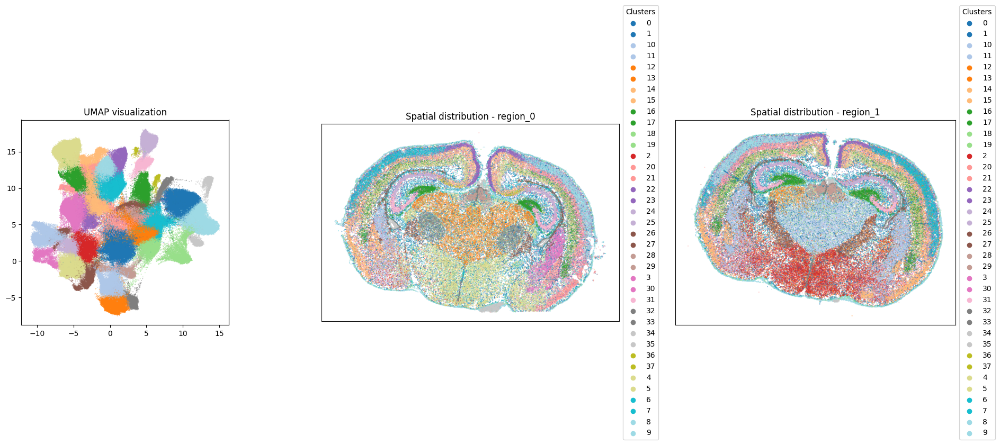

In [32]:
# Visualize all clusters with region_1 flipped
fig = analysis.visualize_spatial_clusters(spot_size=0.1)

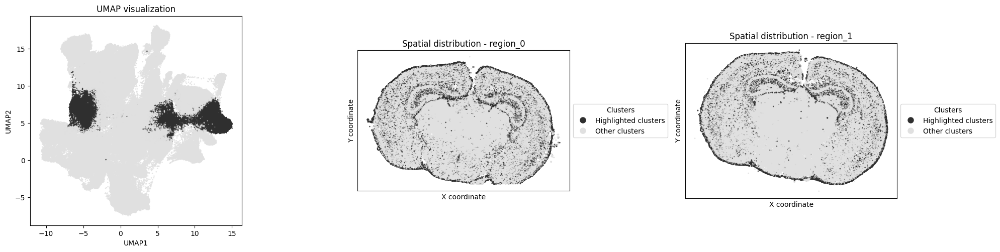

In [33]:
# Highlight specific clusters

fig = analysis.highlight_clusters(
    clusters_to_highlight=['3','6','9'],  # List of cluster IDs to highlight
    spot_size=1.0,
    highlight_color='#2f2f2f',  # Dark gray
    background_color='#e0e0e0'  # Light gray
)



### look at the DEGs between leiden clusters

In [10]:
# Loop through different clusters
clusters = analysis.adata.obs['leiden'].unique()
n_cluster = len(clusters)
for i in range(n_cluster):

    fig = analysis.highlight_clusters(
        clusters_to_highlight=['{}'.format(i)],  # List of cluster IDs to highlight
        spot_size=1.0,
        highlight_color='#2f2f2f',  # Dark gray
        background_color='#e0e0e0'  # Light gray
    )
    # Save the figure
    fig_name = os.path.join(fig_root,'cluster_distribution{}.png'.format(i))
    plt.savefig(fig_name)
    
    # Close the figure to avoid overlapping plots
    plt.close()

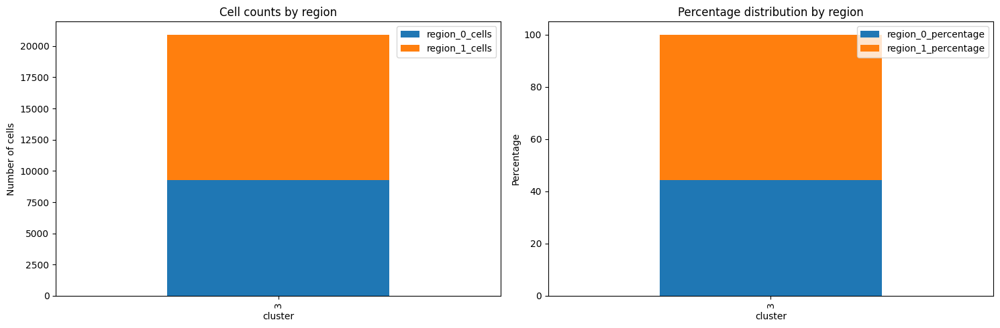

In [11]:
# Get statistics for highlighted clusters
fig_stats, stats_df = analysis.plot_cluster_stats(
    clusters_to_highlight=['3']
)

plt.show()

In [12]:
# Find similar clusters with enhanced analysis
similar_clusters, similarity_matrix, similarity_scores, diagnostics = analysis.find_similar_clusters(
    n_neighbors=3,
    use_raw=False,  # Use log-transformed data
    method='correlation',
    min_expr_threshold=0.1
)

Calculating cluster profiles for 20 clusters...
Using 32 genes for similarity calculation


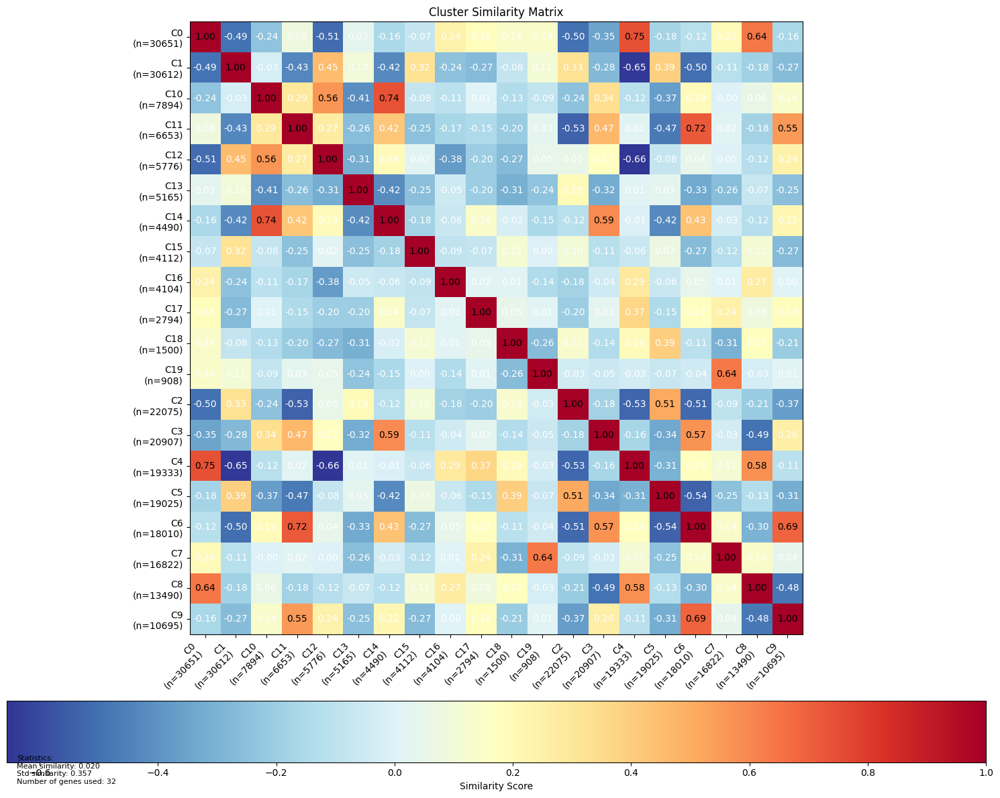

In [13]:
# Visualize similarity matrix
similarity_fig = analysis.visualize_cluster_similarity(
    similarity_matrix,
    diagnostics
)

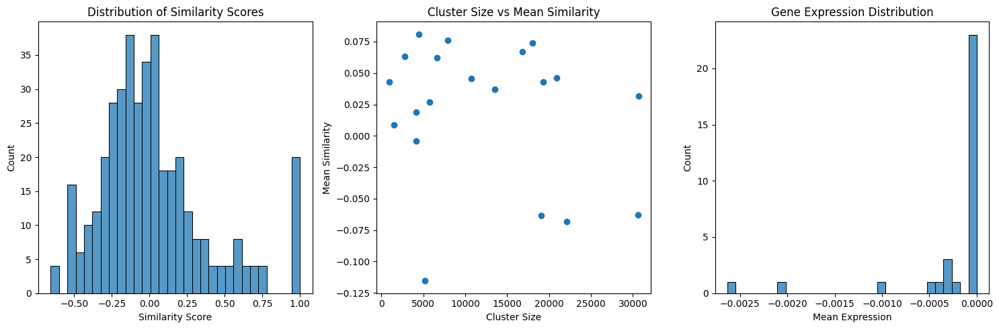

In [14]:
# Plot validation visualizations
validation_fig = analysis.plot_cluster_similarity_validation(
    similarity_matrix,
    diagnostics
)

In [15]:
# Print detailed results for a specific cluster
cluster_id = '7'
print(f"\nMost similar clusters to cluster {cluster_id}:")
for similar_cluster in similar_clusters[cluster_id]:
    score = similarity_scores[cluster_id][similar_cluster]
    print(f"Cluster {similar_cluster}: similarity score = {score:.3f}")

plt.show()


Most similar clusters to cluster 7:
Cluster 19: similarity score = 0.637
Cluster 17: similarity score = 0.243
Cluster 0: similarity score = 0.197


Generating comprehensive marker analysis report...
Finding general markers...
Analyzing cluster similarities...
Calculating cluster profiles for 20 clusters...
Using 32 genes for similarity calculation
Finding specific markers...
Calculating cluster profiles for 20 clusters...
Using 32 genes for similarity calculation
Generating visualizations...
Saving results...


KeyError: 0

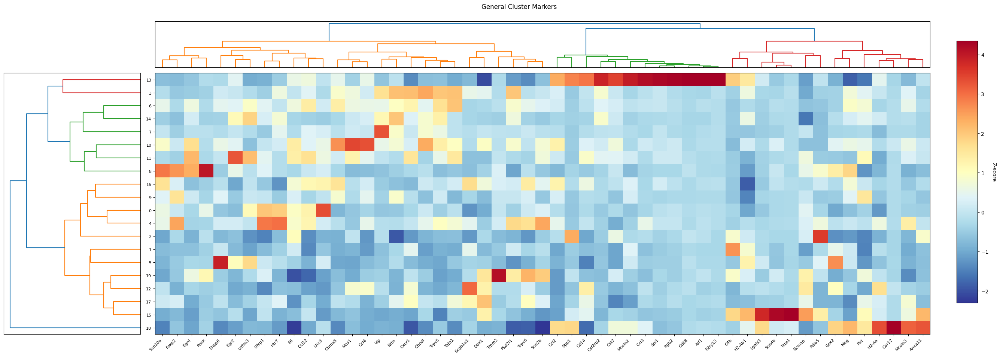

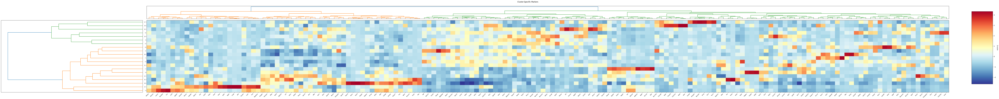

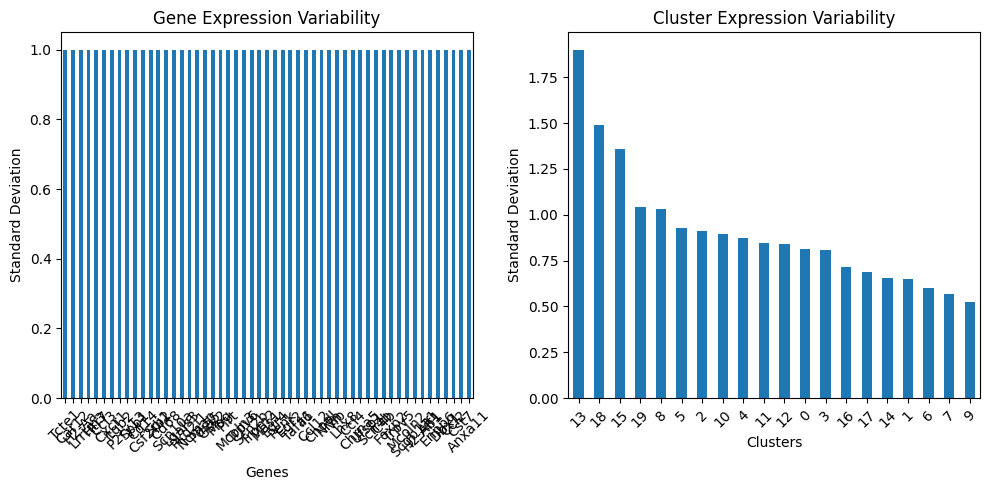

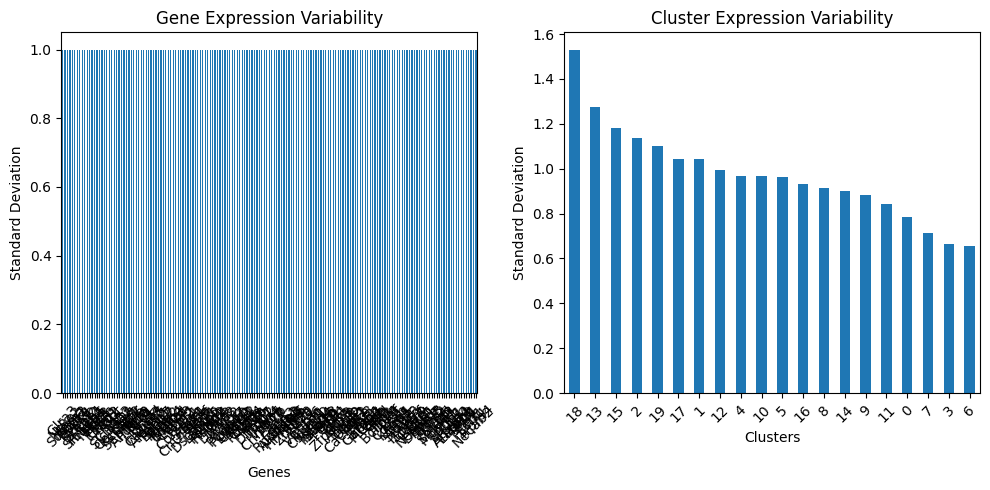

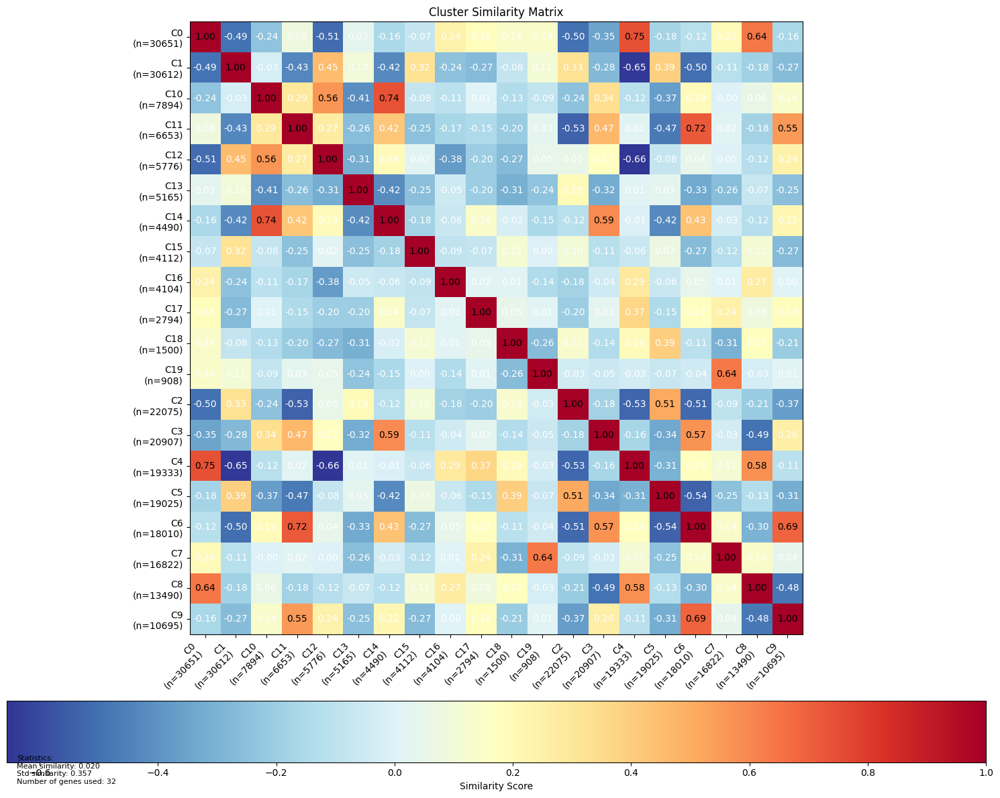

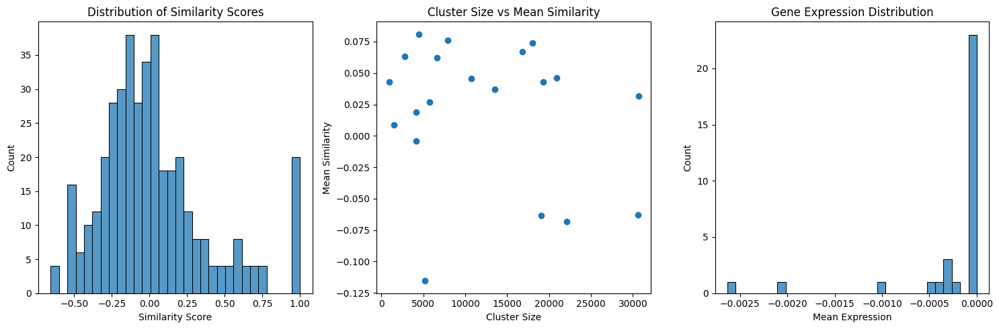

In [16]:
# Generate comprehensive marker analysis with all visualizations
report, figures = analysis.generate_marker_report(
    min_fold_change=1.5,
    max_pval=0.01,
    n_top_genes=10,
    base_figsize=(15, 10),
    min_font_size=8,
    save_path=fig_root
)

In [51]:
# Access specific results
cluster_id = '0'
print("\nTop markers for cluster", cluster_id)
print(report['clusters'][cluster_id]['general_markers']['names'])

# Display figures
for name, fig in figures.items():
    plt.figure(fig.number)
    plt.show()


Top markers for cluster 0


NameError: name 'report' is not defined

### plot gene expression

In [12]:
gene_merscope_CBD_xu =['Aldh1a3','Egr4','Ephb3','Igfbp4','Cdh6','Ache','Cntn6','Prkcb','Vgf','Ntng2','Unc5d',
                      'Itgb4','Vcan','Npnt','Shc3','Itpr1','Galnt9','Ptpru','Spred3','Cryab','Htr7','Hdac9',
                      'Cbln1','Arhgap28','Foxj1']

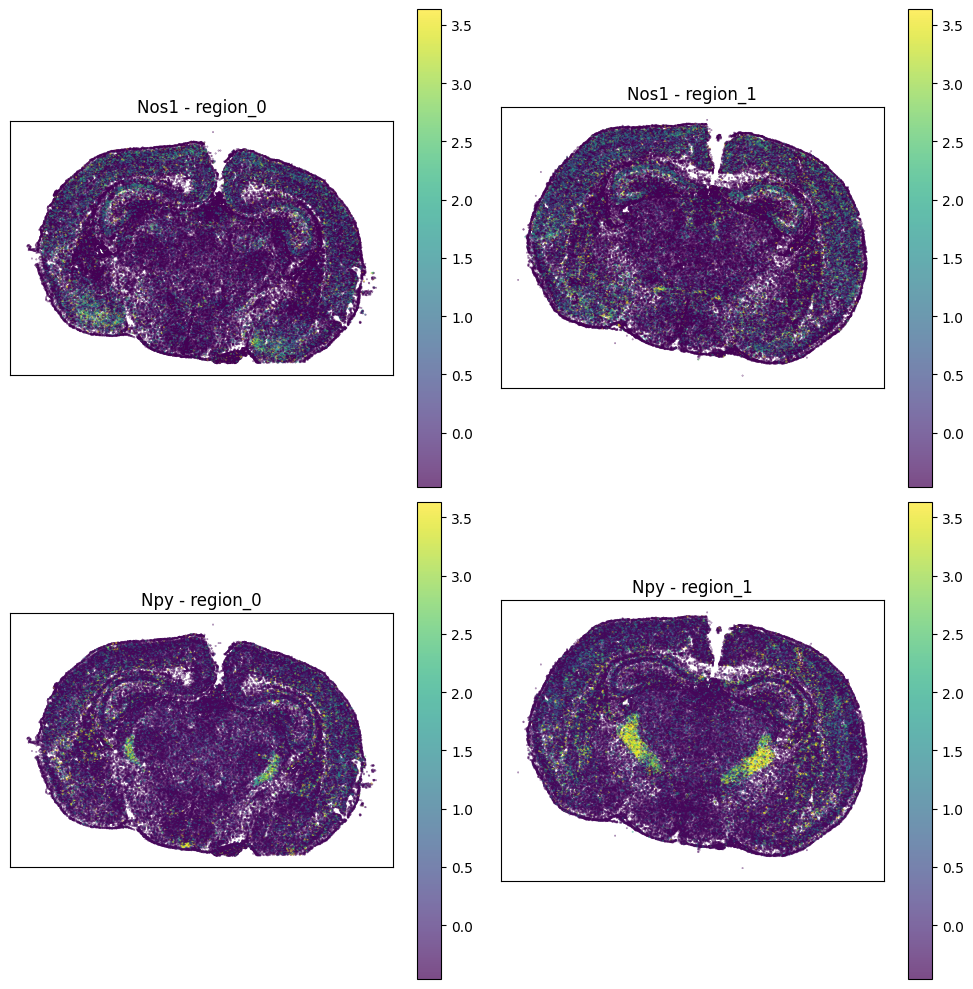

In [15]:
# Plot specific genes
genes_of_interest = ['Rorb', 'Cux2', 'Tbr1', 'Tshz2']
# genes_of_interest=['Cdh13']
genes_of_interest=['St18'] #Dani
genes_of_interest=['Sst','Nos1','Mafb','Dach1','Lyd1','Npy'] #Lynette
genes_of_interest=['Nos1','Npy'] #Lynette


fig = analysis.plot_spatial_gene_expression(
    genes=genes_of_interest,
    spot_size=0.1,
    ncols=2,
    cmap = 'viridis'
)

# sc.pl.umap(analysis.adata, 
#            color= genes_of_interest, 
#            title=genes_of_interest)

In [28]:
# Use a different colormap for continuous data
gene_now = 'Sst'
analysis.plot_spatial_feature(
    gene_now,
    spot_size=1,
    color_map='*gray'  # override default viridis
)
# Save the figure
fig_name = os.path.join(fig_root,'gene_expression_{}.png'.format(gene_now))
plt.savefig(fig_name, dpi =600)

# Close the figure to avoid overlapping plots
plt.close()

KeyError: 'Sst'

<Figure size 1200x600 with 0 Axes>

In [53]:
# Loop through genes and save

# genelist_now = gene_merscope_CBD_xu
genelist_now = genes_of_interest
for gene_now in genelist_now:

    fig = analysis.plot_spatial_gene_expression(
        genes=[gene_now],
        spot_size=1.0,
        ncols=2
    )
    # Save the figure
    fig_name = os.path.join(fig_root,'gene_expression_{}.png'.format(gene_now))
    plt.savefig(fig_name)
    
    # Close the figure to avoid overlapping plots
    plt.close()


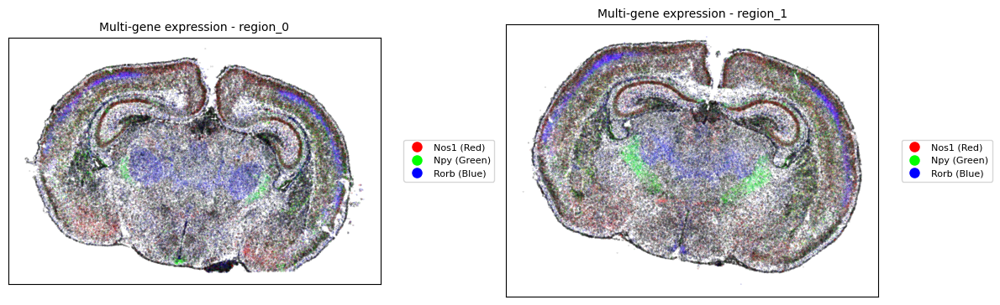

In [18]:
# Plot multiple genes using color channels
list_genes = ['Rorb', 'Tshz2', 'Spred3']
list_genes = ['Aldh1a3','Rorb','Tshz2']
list_genes = ['Arhgap28','Rorb','Tshz2']
list_genes = ['Whrn','Aldh1a3','Rorb']
list_genes = ['Whrn','Aldh1a3','Glp2r']
list_genes = ['Cdh13','Aldh1a3','Whrn']
# list_genes = ['Glp2r','Rorb','Tshz2']
list_genes=['Nos1','Npy','Rorb'] #Lynette

fig = analysis.plot_multicolor_expression(
    genes= list_genes,  # Up to 6 genes
    spot_size=0.01,
    quantile_clip=0.01  # Clips extreme values
)

In [ ]:
# Optionally, show the color reference
fig_ref = analysis.plot_gene_color_reference()

plt.show()

In [21]:
analysis.adata.obs

,Custom Cells groups,Datasets,volume,center_x,center_y,cell_id,class_label,class_name,class_correlation_coefficient,subclass_label,subclass_name,subclass_correlation_coefficient,supertype_label,supertype_name,supertype_correlation_coefficient,cluster_label,cluster_name,cluster_alias,cluster_correlation_coefficient,leiden
4176488300005100074,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,918.626099,3135.893269,407.215646,4176488300005100074,CS20230722_CLAS_33,33 Vascular,0.5529,CS20230722_SUBC_329,329 ABC NN,0.5529,CS20230722_SUPT_1186,1186 ABC NN_1,0.5529,CS20230722_CLUS_5294,5294 ABC NN_1,5257,0.5529,9
4176488300005100077,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1296.579224,3093.065556,416.124569,4176488300005100077,CS20230722_CLAS_14,14 HY Glut,0.3800,CS20230722_SUBC_129,129 VMH Nr5a1 Glut,0.3800,CS20230722_SUPT_0566,0566 VMH Nr5a1 Glut_1,0.3800,CS20230722_CLUS_2304,2304 VMH Nr5a1 Glut_1,2086,0.3800,21
4176488300005100078,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1098.988892,3140.836221,414.966652,4176488300005100078,CS20230722_CLAS_33,33 Vascular,0.5413,CS20230722_SUBC_330,330 VLMC NN,0.5413,CS20230722_SUPT_1187,1187 VLMC NN_1,0.5413,CS20230722_CLUS_5296,5296 VLMC NN_1,5259,0.5413,9
4176488300005100079,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1901.925781,3147.923169,418.713692,4176488300005100079,CS20230722_CLAS_33,33 Vascular,0.6124,CS20230722_SUBC_330,330 VLMC NN,0.6124,CS20230722_SUPT_1187,1187 VLMC NN_1,0.6124,CS20230722_CLUS_5296,5296 VLMC NN_1,5259,0.6124,9
4176488300005100084,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,825.530334,3150.803025,427.134870,4176488300005100084,CS20230722_CLAS_33,33 Vascular,0.4082,CS20230722_SUBC_330,330 VLMC NN,0.4082,CS20230722_SUPT_1187,1187 VLMC NN_1,0.4082,CS20230722_CLUS_5296,5296 VLMC NN_1,5259,0.4082,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4176488700194200069,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,1077.251953,4224.746444,12715.737318,4176488700194200069,CS20230722_CLAS_33,33 Vascular,0.4778,CS20230722_SUBC_330,330 VLMC NN,0.4778,CS20230722_SUPT_1188,1188 VLMC NN_2,0.4778,CS20230722_CLUS_5300,5300 VLMC NN_2,5262,0.4778,9
4176488700194200077,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,879.106812,4137.425501,12724.852494,4176488700194200077,CS20230722_CLAS_30,30 Astro-Epen,0.2980,CS20230722_SUBC_323,323 Ependymal NN,0.2980,CS20230722_SUPT_1176,1176 Ependymal NN_2,0.2980,CS20230722_CLUS_5261,5261 Ependymal NN_2,14877,0.2980,34
4176488700194200083,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,731.352478,4071.412604,12723.966420,4176488700194200083,CS20230722_CLAS_33,33 Vascular,0.2601,CS20230722_SUBC_333,333 Endo NN,0.2601,CS20230722_SUPT_1193,1193 Endo NN_1,0.2601,CS20230722_CLUS_5311,5311 Endo NN_1,5255,0.2601,34
4176488700194200116,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,677.103821,4096.312602,12741.254466,4176488700194200116,CS20230722_CLAS_25,25 Pineal Glut,0.3208,CS20230722_SUBC_262,262 Pineal Crx Glut,0.3208,CS20230722_SUPT_1030,1030 Pineal Crx Glut_1,0.3208,CS20230722_CLUS_4606,4606 Pineal Crx Glut_1,5149,0.3208,34


[<Axes: title={'center': 'leiden - 202411071245_Xu-P5-ms-brain_VMSC08602_region_0'}>,
 <Axes: title={'center': 'leiden - 202411071245_Xu-P5-ms-brain_VMSC08602_region_1'}>]

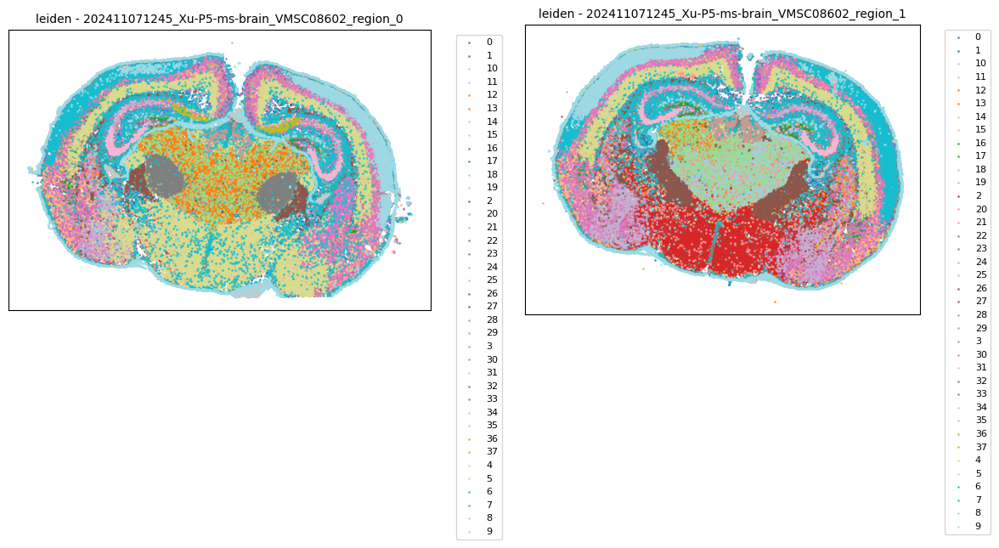

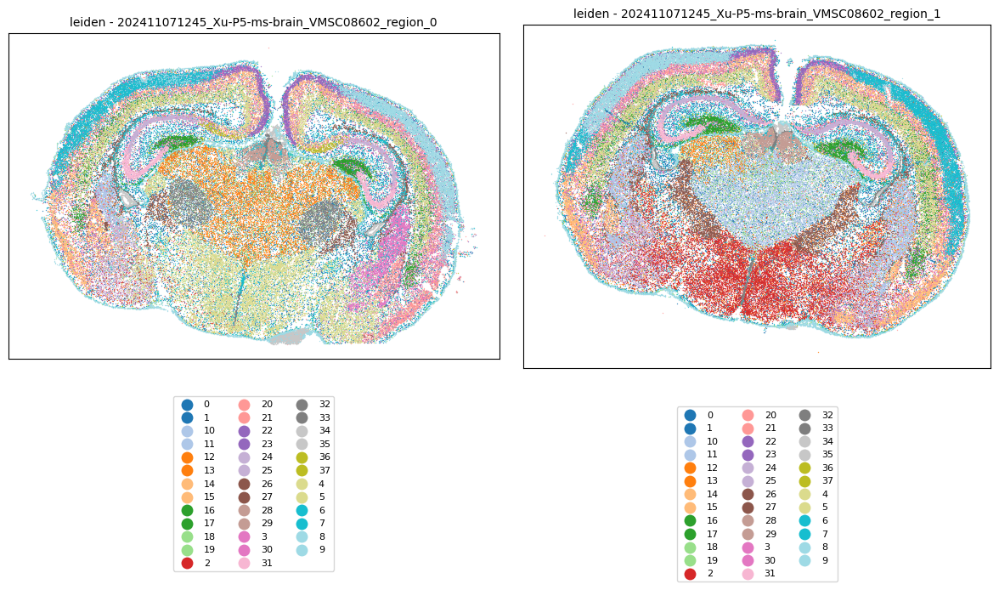

In [14]:
# Plot categorical feature (e.g., clusters)
fig = analysis.plot_spatial_feature(
    'leiden',
    spot_size=1,
    alpha=0.8,
    color_map = 'tab20',
    legend_loc='bottom'
)

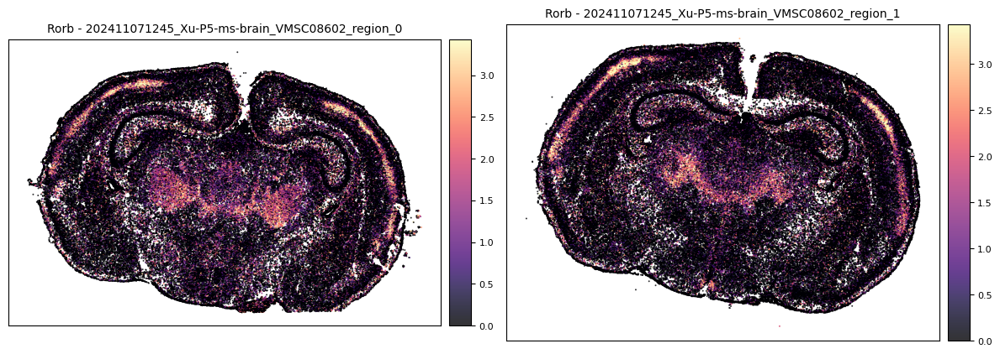

In [15]:
# Plot continuous feature (e.g., gene expression)
fig = analysis.plot_spatial_feature(
    'Rorb',  # gene name
    spot_size=2,
    alpha=0.8,
    color_map='magma',
    vmin=0,
    vmax=None
)


### annotate cell types

In [13]:
# Annotate cell types
analysis.annotate_brain_cells()

In [15]:
analysis.adata.obs

,Custom Cells groups,Datasets,volume,center_x,center_y,leiden,cortical_excitatory_score,cortical_L4_score,cortical_L5_score,cortical_L6_score,thalamic_score,inhibitory_score,astrocytes_score,microglia_score,cell_type,cell_type_confidence
4176488300005100074,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,918.626099,3135.893269,407.215646,2,-0.244656,-0.571089,1.108701,-0.168313,1.897233,-0.623326,-0.282510,-0.180820,thalamic,0.788532
4176488300005100077,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1296.579224,3093.065556,416.124569,0,-0.296395,-0.384818,-0.101315,-0.109518,-0.474885,-0.440989,-0.206453,0.083060,microglia,0.184375
4176488300005100078,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1098.988892,3140.836221,414.966652,2,-0.366667,-0.610635,-0.608639,-0.683328,0.973907,-0.472796,-0.577287,0.215345,thalamic,0.758562
4176488300005100079,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1901.925781,3147.923169,418.713692,2,0.046656,-0.648843,-0.510668,-0.614446,0.274536,-0.485906,0.520885,-0.130789,astrocytes,0.246349
4176488300005100084,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,825.530334,3150.803025,427.134870,2,-0.325396,-0.444894,-0.264873,-0.603404,1.078098,-0.366863,1.275428,0.027888,astrocytes,0.197330
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4176488700194200069,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,1077.251953,4224.746444,12715.737318,2,0.232882,-0.341122,0.561815,-0.361594,-0.522727,-0.392273,-0.324801,-0.149637,cortical_L5,0.328933
4176488700194200077,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,879.106812,4137.425501,12724.852494,15,0.381657,-0.416801,-0.708556,0.104353,-0.748390,-0.673817,-0.649507,-0.304394,cortical_excitatory,0.277304
4176488700194200083,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,731.352478,4071.412604,12723.966420,15,-0.302922,-0.461979,-0.142021,0.389947,1.799669,-0.481091,-0.095872,-0.147054,thalamic,1.409722
4176488700194200116,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,677.103821,4096.312602,12741.254466,15,-0.660451,0.204446,-0.527740,-0.441260,0.432696,-0.473707,-0.206303,-0.154587,thalamic,0.228250


### select ROIs for downstream analysis

Looking for regions in clusters: ['3', '6', '9']
Available clusters: ['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '3', '4', '5', '6', '7', '8', '9']

Starting spatial region identification...
Method: density
Selected clusters: ['3', '6', '9']

Valid clusters found: ['3', '6', '9']

Processing dataset: 202411071245_Xu-P5-ms-brain_VMSC08602_region_0
Found 24116 cells in selected clusters

Starting ROI detection...
Creating density grid...
Calculating density...
Using intensity threshold: 0.000000
Identifying hemispheres...
Left hemisphere: 7490 pixels
Right hemisphere: 9831 pixels
Converting masks to polygons...

Processing left hemisphere:
Added left hemisphere polygon with 10143 points

Processing right hemisphere:
Added right hemisphere polygon with 13569 points
Successfully created 2 ROIs

Processing dataset: 202411071245_Xu-P5-ms-brain_VMSC08602_region_1
Found 25496 cells in selected clusters

Starting ROI detection...
Creating density grid...
Calculat

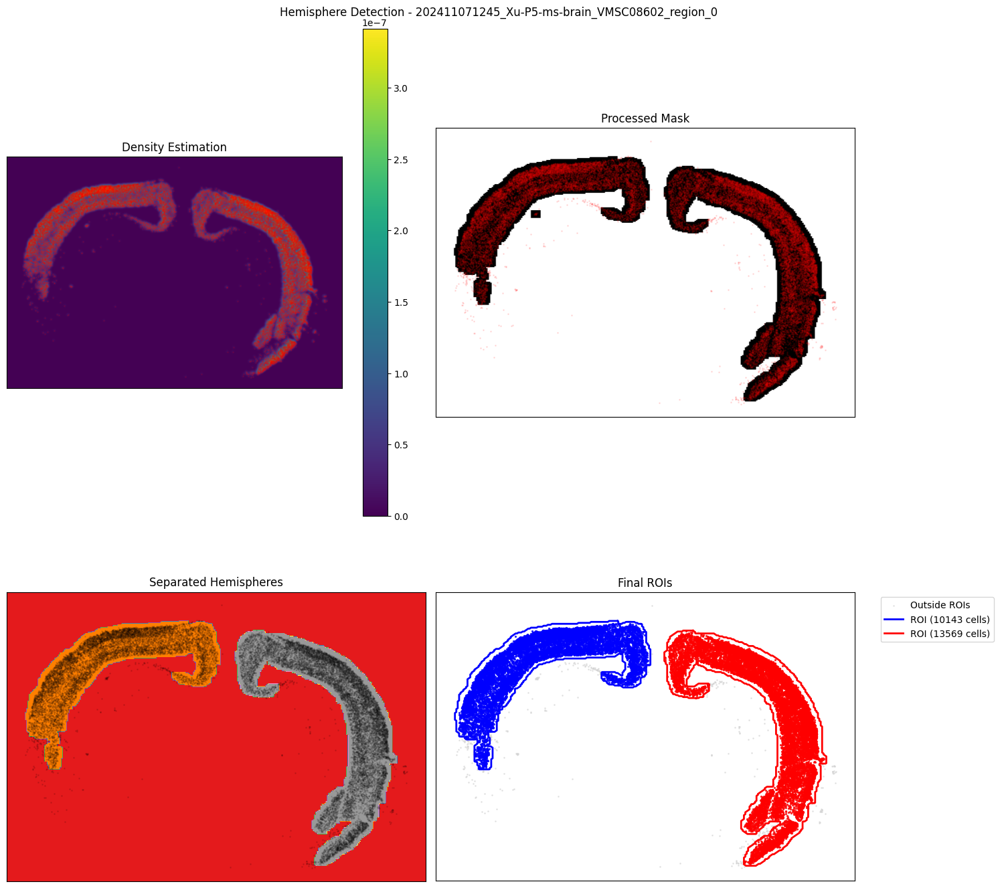

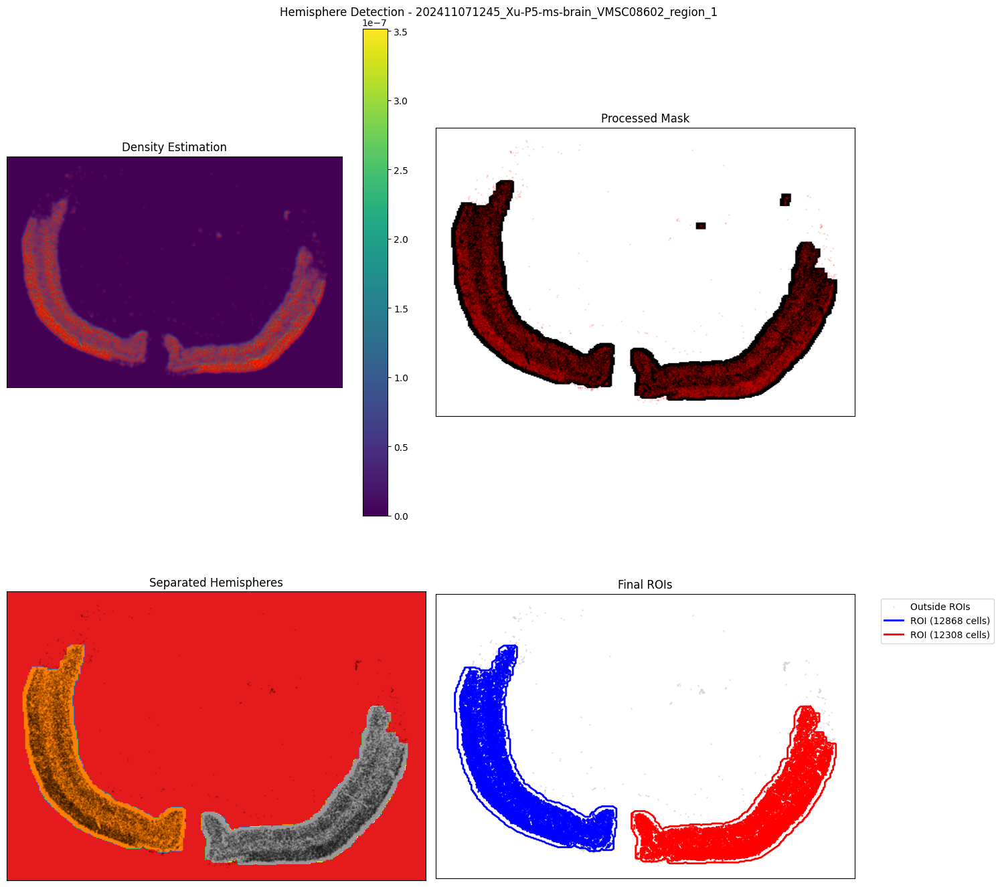

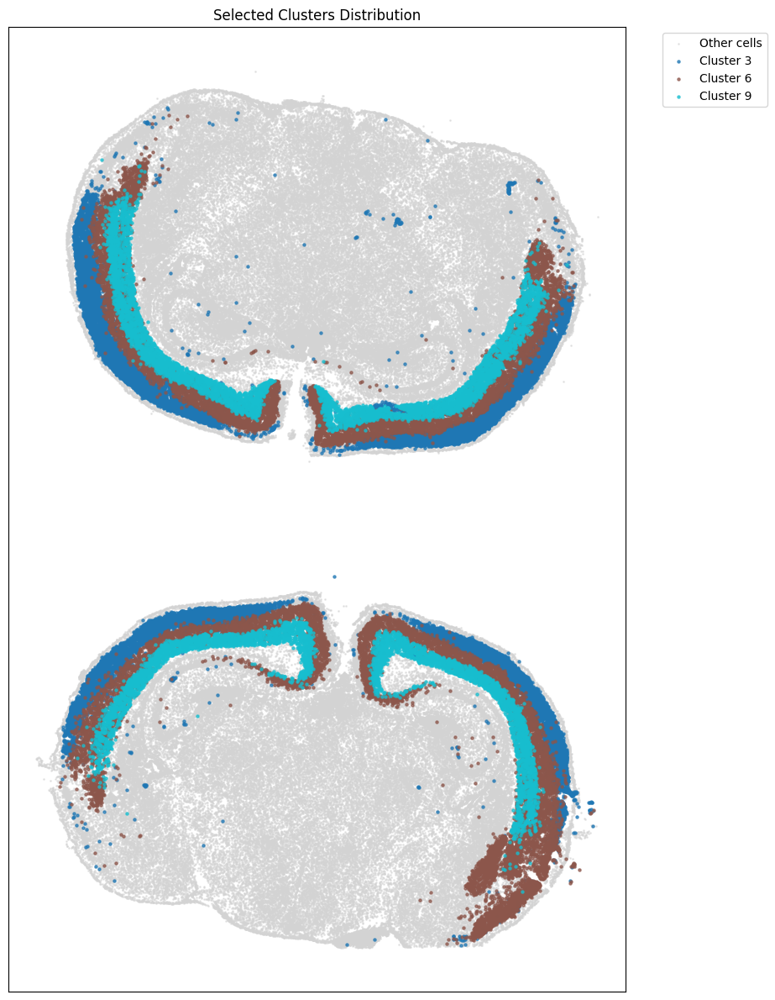

<Figure size 640x480 with 0 Axes>

In [34]:
# Identify regions for specific clusters
clusters_of_interest = ['3', '6', '9']
print(f"Looking for regions in clusters: {clusters_of_interest}")

# Print unique clusters in data
print("Available clusters:", sorted(analysis.adata.obs['leiden'].unique()))

# Using density method with higher resolution
# Detect regions
regions = analysis.identify_spatial_regions(
    clusters=clusters_of_interest,
    method='density',
    grid_resolution=300,
    kernel_bandwidth=30.0,
    min_region_size=100,
    plot_diagnostics=True
)

# View generated diagnostics
if hasattr(analysis, 'diagnostic_figs'):
    for name, fig in analysis.diagnostic_figs.items():
        plt.figure(fig.number)
        plt.show()


Starting region analysis...

Selecting cells within regions...

Processing dataset: 202411071245_Xu-P5-ms-brain_VMSC08602_region_0
Polygon 0: Selected 18087 cells
Polygon 1: Selected 24139 cells

Processing dataset: 202411071245_Xu-P5-ms-brain_VMSC08602_region_1
Polygon 0: Selected 21710 cells
Polygon 1: Selected 21038 cells

Total cells selected: 84974

Running dimension reduction...

Running Leiden clustering...
Found 25 clusters

Cluster sizes:
leiden
0     8198
1     7178
2     7051
3     6762
4     6307
5     4488
6     4183
7     3967
8     3896
9     3843
10    3466
11    3269
12    2967
13    2789
14    2709
15    2389
16    2167
17    2054
18    1828
19    1672
20    1602
21    1031
22     679
23     246
24     233
Name: count, dtype: int64


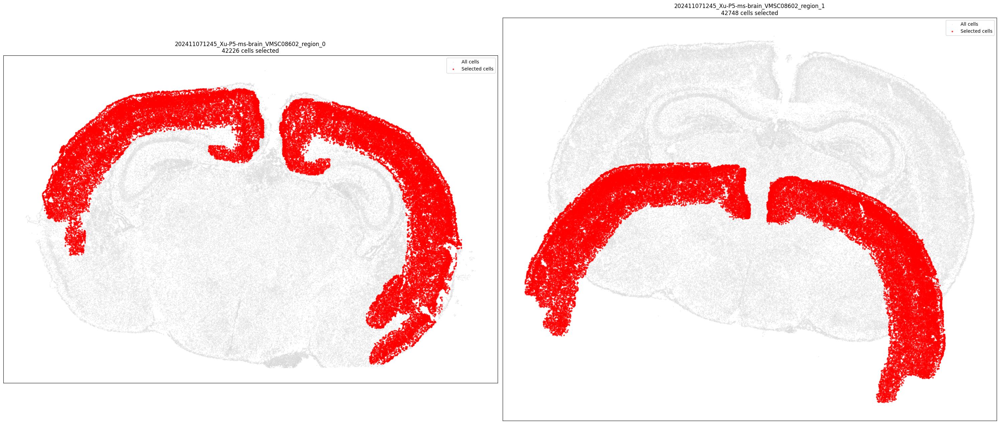

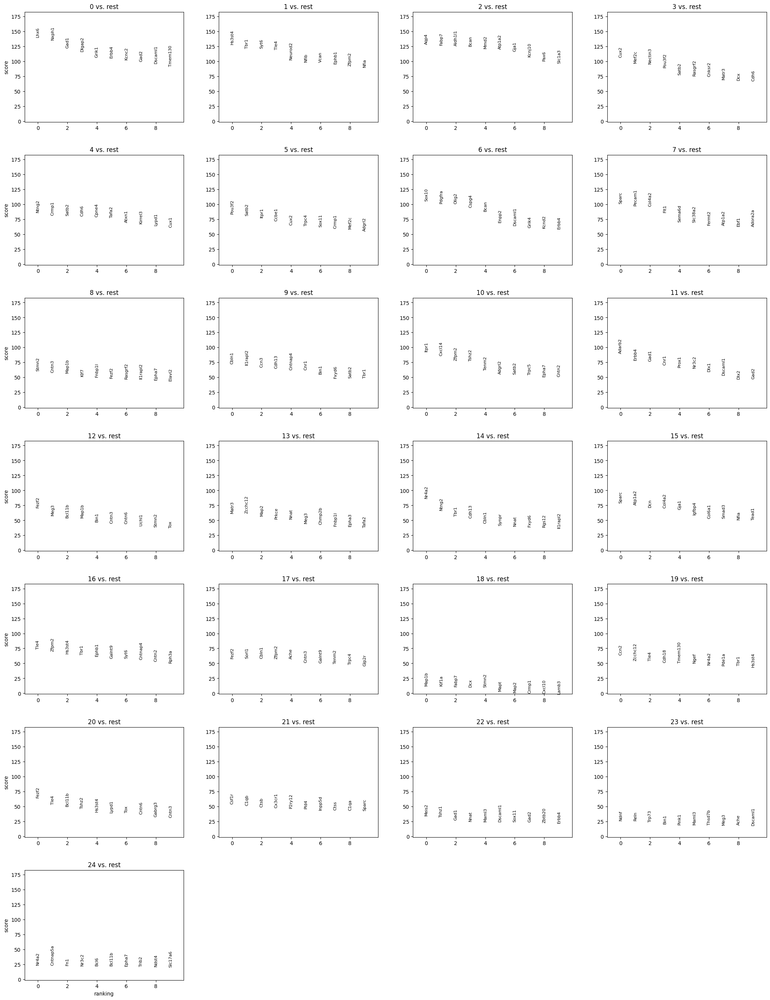

In [36]:
# Analyze regions with detailed reporting
region_adata = analysis.analyze_selected_regions(
    regions,
    n_pcs=25,
    resolution=1.0,
    random_seed=1,
    plot_diagnostics=True
)

# Access results
print("\nCluster sizes:")
print(region_adata.obs['leiden'].value_counts())

# Get marker genes for clusters
sc.tl.rank_genes_groups(region_adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(region_adata, n_genes=10)

In [39]:
region_adata.obs

,Custom Cells groups,Datasets,volume,center_x,center_y,leiden
4176488300069100172,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,2952.766113,1062.663096,2136.872122,2
4176488300069100224,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1689.985474,1074.546250,2158.681751,14
4176488300069100238,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,1845.536255,1073.405822,2169.566025,14
4176488300069100285,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,2160.063965,1056.927163,2204.933301,14
4176488300069100319,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_0,2758.384033,1066.124765,2234.262772,6
...,...,...,...,...,...,...
4176488700116200105,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,1543.213135,8038.046436,10372.712737,7
4176488700116200118,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,1959.196533,7884.457309,10380.286809,6
4176488700116200233,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,1239.579224,7739.074248,10441.033235,19
4176488700116200450,Unclustered,202411071245_Xu-P5-ms-brain_VMSC08602_region_1,1546.707397,7697.320731,10556.962135,0


### save selected region to be processed by step 2

In [40]:
data_dir = '/Users/u0096223/Baidu/Science/Data PVDH/MERSCOPE data/P5_mouse_brain_CBD_panel/Cells'
region_anndata_filename = os.path.join(data_dir,'region_cortex.h5ad')
region_adata.write_h5ad(region_anndata_filename)

In [10]:
anndata_filename

'/Users/u0096223/Baidu/Science/Data PVDH/MERSCOPE data/P5_mouse_brain_CBD_panel/Cells/15-11-24_23-22_P5_mouse_brain_CBD_panel_Cells_clustered.h5ad'

In [ ]:
analysis.adata

In [ ]:
analysis.analyze_gene_gradients(genes=['Gene1', 'Gene2'], cortex_mask=cortex_mask)

In [ ]:
analysis.detect_region_borders()

# Cell-cell interactions
analysis.analyze_cell_interactions(region_mask=visual_system_mask)

# Additional analyses
analysis.spatial_transcriptomics_analysis()
analysis.pathway_analysis(gene_lists=de_genes)